Bayesian Project Model 1 - Bayes Net

In [67]:
import pandas as pd
import numpy as np
import os
import pathlib
import warnings
import probml_utils.pgmpy_utils as pgm
from pgmpy.estimators import MaximumLikelihoodEstimator
from collections.abc import Iterable, Mapping, Sequence
import pgmpy
from pgmpy.models import DiscreteBayesianNetwork
from pgmpy.estimators import HillClimbSearch, ExhaustiveSearch, BIC
from causalgraphicalmodels import CausalGraphicalModel
from pgmpy.factors.discrete import TabularCPD
from pgmpy.inference import VariableElimination
pd.options.display.max_rows = 500
pd.options.display.max_columns = 300
from pgmpy.sampling import BayesianModelSampling
from pgmpy.estimators import HillClimbSearch, ExhaustiveSearch, PC, TreeSearch, BIC, MaximumLikelihoodEstimator
from pgmpy.metrics import structure_score
from sklearn.model_selection import train_test_split
from pgmpy.sampling import BayesianModelSampling
from pgmpy.metrics import structure_score


warnings.filterwarnings("ignore")




In [46]:
diagnosis_data = pd.read_csv("../datasets/C3DC Diagnosis.csv")
participant_data = pd.read_csv("../datasets/C3DC Participants.csv")
treatment_data = pd.read_csv("../datasets/C3DC Treatment Data.csv")
treatment_response_data = pd.read_csv("../datasets/C3DC Treatment Response.csv")

full_treatment_data = treatment_data.merge(
    treatment_response_data,
    on=['Participant ID'],
    how='inner')

full_participant_data = participant_data.merge(
    diagnosis_data,
    on='Participant ID',
    how='inner'
)

full_participant_data = full_participant_data.drop(columns=['Study ID_x', 'Study ID_y', 'Diagnosis ID', 'Diagnosis Comment', 'Diagnosis Classification System', 'Age at Diagnosis (days)'])
full_participant_data['Diagnosis'] = full_participant_data['Diagnosis'].str.extract(r':\s*(.*)')
full_participant_data['Anatomic Site'] = full_participant_data['Anatomic Site'].str.extract(r':\s*(.*)')
full_participant_data.head()


full_treatment_data = full_treatment_data.drop(columns=['Study ID_x', 'Study ID_y', 'Age at Treatment Start', 'Age at Treatment End', 'Treatment ID', 'Age at Response', 'Response System', 'Response Category'])
full_treatment_data.head()

full_participant_data.head()


,Participant ID,Race,Sex at Birth,Diagnosis,Diagnosis Basis,Disease Phase,Tumor Classification,Anatomic Site,Toronto Childhood Cancer Staging,Tumor Grade,Tumor Stage Clinical T,Tumor Stage Clinical N,Tumor Stage Clinical M
0,00301d78915737fa100f,White,Female,"Glioblastoma, NOS",Not Reported,Unknown,Not Reported,Posterior cranial fossa,Not Reported,High Grade,Not Reported,Not Reported,Not Reported
1,0065af91e89ee2859595,Hispanic or Latino;White,Female,"Astrocytoma, anaplastic, NOS",Not Reported,Unknown,Not Reported,Cerebrum,Not Reported,High Grade,Not Reported,Not Reported,Not Reported
2,03d08f8d39e7dcfb3443,White,Male,"Glioma, malignant",Not Reported,Unknown,Not Reported,Brain stem,Not Reported,Not Reported,Not Reported,Not Reported,Not Reported
3,08e314c4b8badeb4ee39,White,Female,"Neuroblastoma, NOS",Not Reported,Unknown,Not Reported,"Nervous system, NOS",Not Reported,Not Reported,T4,Not Reported,Not Reported
4,09aa187c51141be07317,White,Male,"Medulloblastoma, NOS",Not Reported,Unknown,Not Reported,"Cerebellum, NOS",Not Reported,High Grade,T4,Not Reported,Not Reported


In [49]:
for col in full_participant_data.columns:
    print(full_participant_data[col].value_counts())

Participant ID
PT_04V47WFC    42
PT_MDWPRDBT    34
PT_CSZ9QA1N    24
PT_GHTSGFCT    24
PT_3D74J8RZ    22
               ..
PBBZYB          1
PBBZXZ          1
PBBZXG          1
PBBZXE          1
PT_S2M5KJTJ     1
Name: count, Length: 5056, dtype: int64
Race
White                                                                  6077
Not Reported                                                            926
Black or African American                                               747
Hispanic or Latino                                                      705
Hispanic or Latino;White                                                542
Asian                                                                   412
Unknown                                                                 287
American Indian or Alaska Native                                         63
Black or African American;Hispanic or Latino                             57
Black or African American;White                           

In [ ]:
participant_bayes_data = full_participant_data.drop(columns=['Participant ID', 'Tumor Stage Clinical T', 'Tumor Stage Clinical N', 'Tumor Stage Clinical M'])

participant_bayes_data.columns = participant_bayes_data.columns.str.replace(' ', '_')

for col in participant_bayes_data.columns:
    participant_bayes_data[col] = participant_bayes_data[col].astype(str)

participant_bayes_data = participant_bayes_data.fillna('Unknown')

print("Data shape:", participant_bayes_data.shape)
print("\nData types:")
print(participant_bayes_data.dtypes)
print("\nColumn names:", list(participant_bayes_data.columns))
participant_bayes_data.head()


Data shape: (10000, 9)

Data types:
Race                                object
Sex_at_Birth                        object
Diagnosis                           object
Diagnosis_Basis                     object
Disease_Phase                       object
Tumor_Classification                object
Anatomic_Site                       object
Toronto_Childhood_Cancer_Staging    object
Tumor_Grade                         object
dtype: object

Column names: ['Race', 'Sex_at_Birth', 'Diagnosis', 'Diagnosis_Basis', 'Disease_Phase', 'Tumor_Classification', 'Anatomic_Site', 'Toronto_Childhood_Cancer_Staging', 'Tumor_Grade']


,Race,Sex_at_Birth,Diagnosis,Diagnosis_Basis,Disease_Phase,Tumor_Classification,Anatomic_Site,Toronto_Childhood_Cancer_Staging,Tumor_Grade
0,White,Female,"Glioblastoma, NOS",Not Reported,Unknown,Not Reported,Posterior cranial fossa,Not Reported,High Grade
1,Hispanic or Latino;White,Female,"Astrocytoma, anaplastic, NOS",Not Reported,Unknown,Not Reported,Cerebrum,Not Reported,High Grade
2,White,Male,"Glioma, malignant",Not Reported,Unknown,Not Reported,Brain stem,Not Reported,Not Reported
3,White,Female,"Neuroblastoma, NOS",Not Reported,Unknown,Not Reported,"Nervous system, NOS",Not Reported,Not Reported
4,White,Male,"Medulloblastoma, NOS",Not Reported,Unknown,Not Reported,"Cerebellum, NOS",Not Reported,High Grade


In [ ]:
# Method 1: Hill Climb Search
est_hill = HillClimbSearch(participant_bayes_data)
best_hill_model = est_hill.estimate(scoring_method=BIC(participant_bayes_data))

# Method 2: PC Algorithm
est_pc = PC(participant_bayes_data)
best_pc_model = est_pc.estimate()

# Method 3: Hill Climb with constraints\
est_hill_constrained = HillClimbSearch(participant_bayes_data)
best_hill_constrained_model = est_hill_constrained.estimate(
    scoring_method=BIC(participant_bayes_data),
    max_indegree=3,
    max_iter=1000
)

print("Hill Climb edges:", len(best_hill_model.edges()))
print("PC edges:", len(best_pc_model.edges()))
print("Constrained Hill Climb edges:", len(best_hill_constrained_model.edges()))


INFO:pgmpy: Datatype (N=numerical, C=Categorical Unordered, O=Categorical Ordered) inferred from data: 
 {'Race': 'C', 'Sex_at_Birth': 'C', 'Diagnosis': 'C', 'Diagnosis_Basis': 'C', 'Disease_Phase': 'C', 'Tumor_Classification': 'C', 'Anatomic_Site': 'C', 'Toronto_Childhood_Cancer_Staging': 'C', 'Tumor_Grade': 'C'}
INFO:pgmpy: Datatype (N=numerical, C=Categorical Unordered, O=Categorical Ordered) inferred from data: 
 {'Race': 'C', 'Sex_at_Birth': 'C', 'Diagnosis': 'C', 'Diagnosis_Basis': 'C', 'Disease_Phase': 'C', 'Tumor_Classification': 'C', 'Anatomic_Site': 'C', 'Toronto_Childhood_Cancer_Staging': 'C', 'Tumor_Grade': 'C'}
INFO:pgmpy: Datatype (N=numerical, C=Categorical Unordered, O=Categorical Ordered) inferred from data: 
 {'Race': 'C', 'Sex_at_Birth': 'C', 'Diagnosis': 'C', 'Diagnosis_Basis': 'C', 'Disease_Phase': 'C', 'Tumor_Classification': 'C', 'Anatomic_Site': 'C', 'Toronto_Childhood_Cancer_Staging': 'C', 'Tumor_Grade': 'C'}
INFO:pgmpy: Datatype (N=numerical, C=Categorical Uno

  0%|          | 0/1000000 [00:00<?, ?it/s]

INFO:pgmpy: Datatype (N=numerical, C=Categorical Unordered, O=Categorical Ordered) inferred from data: 
 {'Race': 'C', 'Sex_at_Birth': 'C', 'Diagnosis': 'C', 'Diagnosis_Basis': 'C', 'Disease_Phase': 'C', 'Tumor_Classification': 'C', 'Anatomic_Site': 'C', 'Toronto_Childhood_Cancer_Staging': 'C', 'Tumor_Grade': 'C'}


  0%|          | 0/5 [00:00<?, ?it/s]

INFO:pgmpy:Reached maximum number of allowed conditional variables. Exiting
INFO:pgmpy: Datatype (N=numerical, C=Categorical Unordered, O=Categorical Ordered) inferred from data: 
 {'Race': 'C', 'Sex_at_Birth': 'C', 'Diagnosis': 'C', 'Diagnosis_Basis': 'C', 'Disease_Phase': 'C', 'Tumor_Classification': 'C', 'Anatomic_Site': 'C', 'Toronto_Childhood_Cancer_Staging': 'C', 'Tumor_Grade': 'C'}
INFO:pgmpy: Datatype (N=numerical, C=Categorical Unordered, O=Categorical Ordered) inferred from data: 
 {'Race': 'C', 'Sex_at_Birth': 'C', 'Diagnosis': 'C', 'Diagnosis_Basis': 'C', 'Disease_Phase': 'C', 'Tumor_Classification': 'C', 'Anatomic_Site': 'C', 'Toronto_Childhood_Cancer_Staging': 'C', 'Tumor_Grade': 'C'}
INFO:pgmpy: Datatype (N=numerical, C=Categorical Unordered, O=Categorical Ordered) inferred from data: 
 {'Race': 'C', 'Sex_at_Birth': 'C', 'Diagnosis': 'C', 'Diagnosis_Basis': 'C', 'Disease_Phase': 'C', 'Tumor_Classification': 'C', 'Anatomic_Site': 'C', 'Toronto_Childhood_Cancer_Staging': '

  0%|          | 0/1000 [00:00<?, ?it/s]

Hill Climb edges: 6
PC edges: 12
Constrained Hill Climb edges: 6


In [74]:
# Visualize PC model
model_pc = CausalGraphicalModel(nodes=best_pc_model.nodes(), edges=best_pc_model.edges())

dot = model_pc.draw()
print(type(dot))
display(dot)
dot.render(filename="pgm_participant_data_pc", format="pdf")


AssertionError: 

<class 'graphviz.graphs.Digraph'>


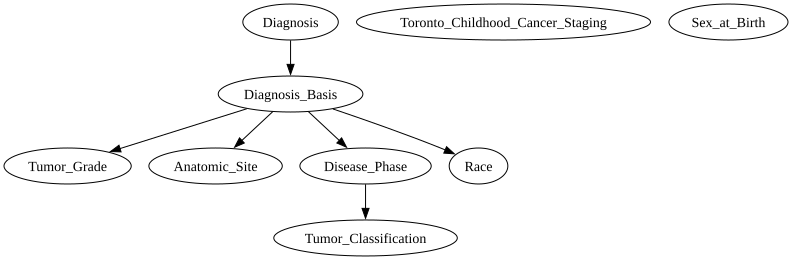

'pgm_participant_data_hill.pdf'

In [75]:
# Visualize Hill Climb model
model4 = CausalGraphicalModel(nodes=best_hill_model.nodes(), edges=best_hill_model.edges())

dot = model4.draw()
print(type(dot))
display(dot)
dot.render(filename="pgm_participant_data_hill", format="pdf")


<class 'graphviz.graphs.Digraph'>


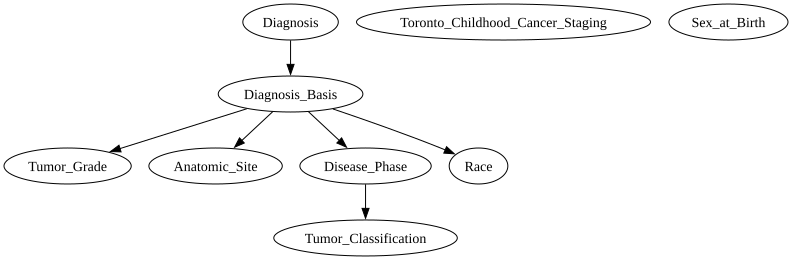

'pgm_participant_data_hill_constrained.pdf'

In [76]:
# Visualize Constrained Hill Climb model
model_constrained = CausalGraphicalModel(nodes=best_hill_constrained_model.nodes(), edges=best_hill_constrained_model.edges())

dot = model_constrained.draw()
print(type(dot))
display(dot)
dot.render(filename="pgm_participant_data_hill_constrained", format="pdf")


In [ ]:
mymodels = [
    ("Constrained Hill Climb", best_hill_constrained_model),
    ("Hill Climb", best_hill_model),
    ("PC Algorithm", best_pc_model)
]

for name, model in mymodels:
    print(f"\n{'='*60}")
    print(f"Model: {name}")
    print(f"{'='*60}")
    print(f"Number of edges: {len(model.edges())}")
    print(f"Number of nodes: {len(model.nodes())}")
    
    if hasattr(model, 'to_dag'):
        model_dag = model.to_dag()
        print("(Converted PDAG to DAG)")
    else:
        model_dag = model
    
    network = DiscreteBayesianNetwork(model_dag)
    mle = MaximumLikelihoodEstimator(network, participant_bayes_data)
    
    for cpd in mle.get_parameters():
        network.add_cpds(cpd)
    
    dot = pgm.visualize_model(network)
    dot.attr(size='6,6')
    dot.attr('node', fontsize='8')
    dot.attr('edge', fontsize='6')
    display(dot)
    
    bic_scorer = BIC(participant_bayes_data)
    bic_score = bic_scorer.score(model_dag)
    print(f'BIC score: {bic_score:.2f}')
    print(f"(Lower BIC is better)")


INFO:pgmpy: Datatype (N=numerical, C=Categorical Unordered, O=Categorical Ordered) inferred from data: 
 {'Race': 'C', 'Sex_at_Birth': 'C', 'Diagnosis': 'C', 'Diagnosis_Basis': 'C', 'Disease_Phase': 'C', 'Tumor_Classification': 'C', 'Anatomic_Site': 'C', 'Toronto_Childhood_Cancer_Staging': 'C', 'Tumor_Grade': 'C'}



Model: Constrained Hill Climb
Number of edges: 6
Number of nodes: 9


INFO:pgmpy: Datatype (N=numerical, C=Categorical Unordered, O=Categorical Ordered) inferred from data: 
 {'Race': 'C', 'Sex_at_Birth': 'C', 'Diagnosis': 'C', 'Diagnosis_Basis': 'C', 'Disease_Phase': 'C', 'Tumor_Classification': 'C', 'Anatomic_Site': 'C', 'Toronto_Childhood_Cancer_Staging': 'C', 'Tumor_Grade': 'C'}
INFO:pgmpy: Datatype (N=numerical, C=Categorical Unordered, O=Categorical Ordered) inferred from data: 
 {'Race': 'C', 'Sex_at_Birth': 'C', 'Diagnosis': 'C', 'Diagnosis_Basis': 'C', 'Disease_Phase': 'C', 'Tumor_Classification': 'C', 'Anatomic_Site': 'C', 'Toronto_Childhood_Cancer_Staging': 'C', 'Tumor_Grade': 'C'}
INFO:pgmpy: Datatype (N=numerical, C=Categorical Unordered, O=Categorical Ordered) inferred from data: 
 {'Race': 'C', 'Sex_at_Birth': 'C', 'Diagnosis': 'C', 'Diagnosis_Basis': 'C', 'Disease_Phase': 'C', 'Tumor_Classification': 'C', 'Anatomic_Site': 'C', 'Toronto_Childhood_Cancer_Staging': 'C', 'Tumor_Grade': 'C'}


BIC score: -83323.26
(Lower BIC is better)

Model: Hill Climb
Number of edges: 6
Number of nodes: 9


INFO:pgmpy: Datatype (N=numerical, C=Categorical Unordered, O=Categorical Ordered) inferred from data: 
 {'Race': 'C', 'Sex_at_Birth': 'C', 'Diagnosis': 'C', 'Diagnosis_Basis': 'C', 'Disease_Phase': 'C', 'Tumor_Classification': 'C', 'Anatomic_Site': 'C', 'Toronto_Childhood_Cancer_Staging': 'C', 'Tumor_Grade': 'C'}
INFO:pgmpy: Datatype (N=numerical, C=Categorical Unordered, O=Categorical Ordered) inferred from data: 
 {'Race': 'C', 'Sex_at_Birth': 'C', 'Diagnosis': 'C', 'Diagnosis_Basis': 'C', 'Disease_Phase': 'C', 'Tumor_Classification': 'C', 'Anatomic_Site': 'C', 'Toronto_Childhood_Cancer_Staging': 'C', 'Tumor_Grade': 'C'}
INFO:pgmpy: Datatype (N=numerical, C=Categorical Unordered, O=Categorical Ordered) inferred from data: 
 {'Race': 'C', 'Sex_at_Birth': 'C', 'Diagnosis': 'C', 'Diagnosis_Basis': 'C', 'Disease_Phase': 'C', 'Tumor_Classification': 'C', 'Anatomic_Site': 'C', 'Toronto_Childhood_Cancer_Staging': 'C', 'Tumor_Grade': 'C'}


BIC score: -83323.26
(Lower BIC is better)

Model: PC Algorithm
Number of edges: 12
Number of nodes: 9
(Converted PDAG to DAG)


INFO:pgmpy: Datatype (N=numerical, C=Categorical Unordered, O=Categorical Ordered) inferred from data: 
 {'Race': 'C', 'Sex_at_Birth': 'C', 'Diagnosis': 'C', 'Diagnosis_Basis': 'C', 'Disease_Phase': 'C', 'Tumor_Classification': 'C', 'Anatomic_Site': 'C', 'Toronto_Childhood_Cancer_Staging': 'C', 'Tumor_Grade': 'C'}


BIC score: -460105.82
(Lower BIC is better)
